# 01_Preprocessing Gunshots 
#### Laying out the basic code for preprocessing of audio samples

In [2]:
#Importing Packages
import matplotlib.pyplot as plt
import warnings
import numpy as np
import pandas as pd
import os
import librosa
import librosa.display
from scipy.ndimage import zoom
from tqdm import tqdm

# Suppress the warning
warnings.filterwarnings('ignore', message='Trying to estimate tuning from empty frequency set.')

In [3]:
#Preprocessing basic code
'''
Change folder path to your gunshot folder
Ref: E:\Datasets\Gunshots\isolated-rainforest-gunshots_23-05-15_1439\Gunshot_Range_Tests_Results\Data\gunshot
'''
folder_path = 'E:\Datasets\Gunshots\isolated-rainforest-gunshots_23-05-15_1439\Gunshot_Range_Tests_Results\Data\gunshot'

pickle_file_path = 'output.pickle'
if os.path.exists(pickle_file_path):
    # Load the DataFrame from the pickle file
    audio_data = pd.read_pickle(pickle_file_path)
    print('audio_data loaded')
    
else:
    # Initialize lists to store the extracted data
    file_names = []
    r_types = []
    r_names = []
    distances = []
    dates = []
    years = []
    gunshots = []
    signals = []
    sample_rates = []
    durations = []
    mel_spectrograms = []
    log_mel_spectrograms = []
    mfccs = []
    ssms = []
    shapes = []
    lms_rs = []
    mfcc_rs = []
    ssm_rs = []

    # Iterate over the files in the folder with tqdm progress bar
    for filename in tqdm(os.listdir(folder_path), desc='Preprocessing folder > saving as pickle'):
        if filename.endswith('.wav'):
            # Extract the desired information from the file name
            file_name = filename.split('.')[0]
            file_name_parts = file_name.split('_')
            r_type, r_name, distance, date, year = file_name_parts

            # Preprocess the file and extract additional information
            file_path = os.path.join(folder_path, filename)
            audio, sample_rate = librosa.load(file_path)
            duration = len(audio) / float(sample_rate)
            mel_spectrogram = librosa.feature.melspectrogram(y=audio, sr=sample_rate, n_mels=128)
            log_mel_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)
            mfcc = librosa.feature.mfcc(y=audio, sr=sample_rate)

            #calculate self similarity matrix
            hop_length = 1024
            chroma = librosa.feature.chroma_cqt(y=audio, sr=sample_rate, hop_length=hop_length)
            chroma_stack = librosa.feature.stack_memory(chroma, n_steps=10, delay=3)
            R = librosa.segment.recurrence_matrix(chroma_stack)
            R_aff = librosa.segment.recurrence_matrix(chroma_stack, metric='cosine', mode='affinity')
            ssm = R_aff
            
            #shape of resulting image
            desired_shape = (128,128)
            
            #normalise lms, mfccs, ssm
            log_mel_spectrogram_norm = (log_mel_spectrogram - np.min(log_mel_spectrogram)) / (np.max(log_mel_spectrogram) - np.min(log_mel_spectrogram))
            mfcc_norm = (mfcc - np.min(mfcc)) / (np.max(mfcc) - np.min(mfcc))
            ssm_norm = (ssm - np.min(ssm)) / (np.max(ssm) - np.min(ssm))
            
            #resized according to shape
            lms_r = zoom(log_mel_spectrogram_norm, (desired_shape[0] / log_mel_spectrogram_norm.shape[0], desired_shape[1] / log_mel_spectrogram_norm.shape[1]))
            mfcc_r = zoom(mfcc_norm, (desired_shape[0] / mfcc_norm.shape[0], desired_shape[1] / mfcc_norm.shape[1]))
            ssm_r = zoom(ssm_norm, (desired_shape[0] / ssm_norm.shape[0], desired_shape[1] / ssm_norm.shape[1]))
            
            #gunshots == yes for this particular data set
            #becareful with this when using it for other folders other than Gunshot_Range_Tests_Results\Data\gunshot
            gunshot = 'yes'
            
            # Append the extracted data to the lists
            file_names.append(file_name)
            r_types.append(r_type)
            r_names.append(r_name)
            distances.append(distance)
            dates.append(date)
            years.append(year)
            gunshots.append(gunshot)
            signals.append(audio)
            sample_rates.append(sample_rate)
            durations.append(duration)
            mel_spectrograms.append(mel_spectrogram)
            log_mel_spectrograms.append(log_mel_spectrogram)
            mfccs.append(mfcc)
            ssms.append(ssm)
            shapes.append(desired_shape)
            lms_rs.append(lms_r)
            mfcc_rs.append(mfcc_r)
            ssm_rs.append(ssm_r)

    # Create a dictionary of the extracted data
    data = {
        'file_name': file_names,
        'r_type': r_types,
        'r_name': r_names,
        'distance': distances,
        'date': dates,
        'year': years,
        'gunshot': gunshots,
        'signal': signals,
        'sample_rate': sample_rates,
        'duration': durations,
        'mel_spectrogram': mel_spectrograms,
        'log_mel_spectrogram': log_mel_spectrograms,
        'mfcc': mfccs,
        'ssm': ssms,
        'shape': shapes,
        'lms_r': lms_rs, #use for image gen
        'mfcc_r': mfcc_rs, #use for image gen
        'ssm_r': ssm_rs #use for image gen
    }

    # Create a DataFrame from the extracted data
    audio_data = pd.DataFrame(data)

    # Define the output file path
    pickle_file_path = 'output.pickle'

    # Save the DataFrame to a pickle file
    audio_data.to_pickle(pickle_file_path)

Preprocessing folder > saving as pickle: 100%|███████████████████████████████████████| 285/285 [04:33<00:00,  1.04it/s]


In [17]:
#Audio Player ix = index of file
ix = 25; signal, sr = audio_data.iloc[ix]['signal'], audio_data.iloc[ix]['sample_rate']
Audio(data = signal, rate = sr)

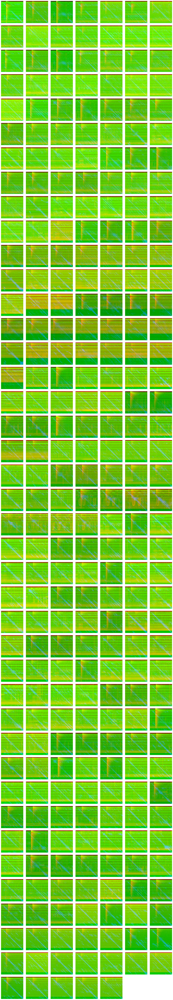

In [23]:
# Define the number of columns for the grid
num_columns = 7

# Define the size of each subplot (in inches)
subplot_size = 3

# Calculate the number of rows based on the number of columns and audio data length
num_rows = len(audio_data) // num_columns + 1

# Calculate the figure size based on the number of rows and columns, and the subplot size
fig_width = num_columns * subplot_size
fig_height = num_rows * subplot_size

# Set the figure size
fig, axs = plt.subplots(num_rows, num_columns, figsize=(fig_width, fig_height))

# Iterate over the length of audio_data
for p in range(len(audio_data)):
    # Retrieve the data for each iteration
    lms_r = audio_data.iloc[p]['lms_r']
    mfcc_r = audio_data.iloc[p]['mfcc_r']
    ssm_r = audio_data.iloc[p]['ssm_r']

    # Create the image
    image = np.stack([lms_r, mfcc_r, ssm_r], axis=-1)
    image = np.clip(image, 0, 1)

    # Get the current subplot axes
    ax = axs[p // num_columns, p % num_columns]

    # Display the image on the subplot
    ax.imshow(image)
    ax.axis('off')

# Remove any extra subplots if the number of images is not a multiple of num_columns
if len(audio_data) % num_columns != 0:
    for p in range(len(audio_data) % num_columns, num_columns):
        fig.delaxes(axs[-1, p])

# Adjust the spacing between subplots
plt.subplots_adjust(wspace=0.1, hspace=0.1)

# Display the grid of images
plt.show()
